In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
# read the dataset and display table information
df_23 = pd.read_csv('../data/clean/cleaned_df_23.csv')

In [3]:
display(df_23, df_23.info(), df_23.nunique())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48042 entries, 0 to 48041
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   country           48042 non-null  object 
 1   age_range         48042 non-null  object 
 2   employment        48042 non-null  object 
 3   work_location     48042 non-null  object 
 4   education_level   48042 non-null  object 
 5   years_coding      48042 non-null  float64
 6   years_coding_pro  48042 non-null  float64
 7   type              48042 non-null  object 
 8   currency          48042 non-null  object 
 9   salary            48042 non-null  float64
dtypes: float64(3), object(7)
memory usage: 3.7+ MB


,country,age_range,employment,work_location,education_level,years_coding,years_coding_pro,type,currency,salary
0,United States of America,25-34 years old,"Employed, full-time",Remote,Bachelor Degree,18.0,9.0,Specialist,USD,2.850000e+05
1,United States of America,45-54 years old,"Employed, full-time",Hybrid,Bachelor Degree,27.0,23.0,Back-End Developer,USD,2.500000e+05
2,United States of America,25-34 years old,"Employed, full-time",Hybrid,Bachelor Degree,12.0,7.0,Front-End Developer,USD,1.560000e+05
3,Other,25-34 years old,Freelancer/Contractor,Remote,Bachelor Degree,6.0,4.0,Full Stack Developer,PHP,1.320000e+06
4,United Kingdom of Great Britain and Northern I...,35-44 years old,"Employed, full-time",Remote,Some College,21.0,21.0,Back-End Developer,GBP,7.800000e+04
...,...,...,...,...,...,...,...,...,...,...
48037,United States of America,25-34 years old,"Employed, full-time",Remote,Bachelor Degree,10.0,8.0,Other Developer,USD,1.350000e+05
48038,Other,35-44 years old,"Employed, full-time",Remote,Master Degree,17.0,11.0,Full Stack Developer,MXN,1.000000e+06
48039,United States of America,45-54 years old,"Employed, full-time",Remote,Bachelor Degree,25.0,22.0,Full Stack Developer,USD,2.120210e+05
48040,Brazil,25-34 years old,Freelancer/Contractor,Remote,Some College,20.0,5.0,Front-End Developer,BRL,2.000000e+05


None

country               27
age_range              6
employment             3
work_location          3
education_level        6
years_coding          50
years_coding_pro      50
type                  17
currency              38
salary              3812
dtype: int64

In [4]:
#standardise currency to EUR

In [5]:
print(df_23['currency'].value_counts())

currency
USD      13521
EUR      13361
GBP       3569
CAD       2088
INR       1870
Other     1654
AUD       1210
BRL       1169
PLN       1139
SEK       1044
CHF        664
DKK        513
NOK        478
CZK        457
ILS        450
NZD        410
RUB        396
ZAR        339
TRY        309
MXN        288
RON        269
HUF        267
COP        227
PKR        222
BGN        221
UAH        207
IRR        194
JPY        183
CNY        157
ARS        154
IDR        154
BDT        151
SGD        139
CLP        123
PHP        120
MYR        117
KRW        107
NGN        101
Name: count, dtype: int64


In [6]:
# Exchange rates to EUR
exchange_rates = {
    'EUR': 1.00,
    'USD': 0.92,
    'GBP': 1.16,
    'INR': 0.011,
    'CAD': 0.67,
    'UAH': 0.025,
    'BRL': 0.18,
    'PLN': 0.21,
    'AUD': 0.59,
    'SEK': 0.086,
    'CHF': 1.04,
    'CZK': 0.041,
    'RUB': 0.0095,
    'DKK': 0.13,
    'NOK': 0.087,
    'ILS': 0.24,
    'NZD': 0.55,
    'ZAR': 0.049,
    'MXN': 0.052,
    'TRY': 0.034,
    'HUF': 0.0026,
    'RON': 0.20,
    'PKR': 0.0032,
    'BGN': 0.51,
    'IRR': 0.000022,
    'JPY': 0.0063,
    'BDT': 0.0086,
    'TWD': 0.029,
    'IDR': 0.000061,
    'COP': 0.00022,
    'CNY': 0.13
}

other_exchange_rates = {
    'NGN': 0.0012,
    'SGD': 0.64,
    'KRW': 0.0007,
    'VND': 0.000039,
    'ARS': 0.0026,
    'CLP': 0.0011,
    'HKD': 0.12,
    'AED': 0.25,
    'LKR': 0.0028,
    'PHP': 0.017,
    'RSD': 0.0085,
    'MYR': 0.21,
    'EGP': 0.029,
    'THB': 0.026,
    'KES': 0.0065,
    'NPR': 0.0071,
    'GEL': 0.35,
    'MAD': 0.090,
    'KZT': 0.002,
    'PEN': 0.23,
    'TND': 0.30,
    'UYU': 0.022,
    'AMD': 0.0018,
    'BAM': 0.51,
    'SAR': 0.25,
    'DOP': 0.016,
    'GHS': 0.079,
    'XOF': 0.0015,
    'PYG': 0.00014,
    'ETB': 0.017,
    'BOB': 0.13,
    'GTQ': 0.12,
    'UZS': 0.000079,
    'BYN': 0.37,
    'JOD': 1.29,
    'ISK': 0.0071,
    'AFN': 0.011,
    'CRC': 0.0017,
    'AZN': 0.53,
    'DZD': 0.0068,
    'MKD': 0.016,
    'MDL': 0.052,
    'IQD': 0.00063,
    'TZS': 0.00037,
    'UGX': 0.00024,
    'KGS': 0.010,
    'ALL': 0.0093,
    'MVR': 0.058,
    'MUR': 0.020,
    'RWF': 0.00080,
    'XAF': 0.0015,
    'HNL': 0.038,
    'FJD': 0.42,
    'SYP': 0.00040,
    'MGA': 0.00020,
    'TMT': 0.27,
    'ZMW': 0.048,
    'MMK': 0.00044,
    'BHD': 2.44,
    'JMD': 0.0060,
    'QAR': 0.25,
    'AOA': 0.0011,
    'TTD': 0.14,
    'MNT': 0.00027,
    'MWK': 0.00080,
    'MZN': 0.014,
    'NIO': 0.025,
    'KWD': 3.04,
    'XPF': 0.0084,
    'OMR': 2.40,
    'YER': 0.0037,
    'VES': 0.000025,
    'GGP': 1.16,
    'ANG': 0.51,
    'NAD': 0.049,
    'BTN': 0.011,
    'MOP': 0.11,
    'BIF': 0.00035,
    'KHR': 0.00022,
    'CUP': 0.036,
    'TJS': 0.083,
    'MRU': 0.024,
    'CVE': 0.0091,
    'SRD': 0.025,
    'SZL': 0.049,
    'BWP': 0.069,
    'FKP': 1.16,
    'BND': 0.64,
    'WST': 0.34,
    'IMP': 1.16,
    'XDR': 1.29,
    'SOS': 0.0016,
    'LBP': 0.00006,
    'BSD': 0.92,
    'LYD': 0.19,
    'SLL': 0.000043,
    'GYD': 0.0044,
    'KPW': 0.00092,
    'AWG': 0.51
}
other_median_rate = pd.Series(list(other_exchange_rates.values())).median()

# Apply the conversion to EUR for each row
df_23['salary_eur'] = df_23.apply(lambda row: row['salary'] * exchange_rates.get(row['currency'], other_median_rate if row['currency'] == 'Other' else exchange_rates.get(row['currency'], 1)), axis=1)

# Verify the new column
df_23[['currency', 'salary', 'salary_eur']].tail(30)

,currency,salary,salary_eur
48012,ZAR,5.400000e+05,26460.00
48013,USD,2.500000e+05,230000.00
48014,COP,7.200000e+07,15840.00
48015,USD,2.150000e+05,197800.00
48016,USD,8.400000e+04,77280.00
48017,USD,2.500000e+05,230000.00
48018,USD,9.000000e+04,82800.00
48019,EUR,1.200000e+05,120000.00
48020,USD,4.500000e+04,41400.00
48021,EUR,1.500000e+03,1500.00


In [7]:
display(df_23)

,country,age_range,employment,work_location,education_level,years_coding,years_coding_pro,type,currency,salary,salary_eur
0,United States of America,25-34 years old,"Employed, full-time",Remote,Bachelor Degree,18.0,9.0,Specialist,USD,2.850000e+05,262200.00
1,United States of America,45-54 years old,"Employed, full-time",Hybrid,Bachelor Degree,27.0,23.0,Back-End Developer,USD,2.500000e+05,230000.00
2,United States of America,25-34 years old,"Employed, full-time",Hybrid,Bachelor Degree,12.0,7.0,Front-End Developer,USD,1.560000e+05,143520.00
3,Other,25-34 years old,Freelancer/Contractor,Remote,Bachelor Degree,6.0,4.0,Full Stack Developer,PHP,1.320000e+06,1320000.00
4,United Kingdom of Great Britain and Northern I...,35-44 years old,"Employed, full-time",Remote,Some College,21.0,21.0,Back-End Developer,GBP,7.800000e+04,90480.00
...,...,...,...,...,...,...,...,...,...,...,...
48037,United States of America,25-34 years old,"Employed, full-time",Remote,Bachelor Degree,10.0,8.0,Other Developer,USD,1.350000e+05,124200.00
48038,Other,35-44 years old,"Employed, full-time",Remote,Master Degree,17.0,11.0,Full Stack Developer,MXN,1.000000e+06,52000.00
48039,United States of America,45-54 years old,"Employed, full-time",Remote,Bachelor Degree,25.0,22.0,Full Stack Developer,USD,2.120210e+05,195059.32
48040,Brazil,25-34 years old,Freelancer/Contractor,Remote,Some College,20.0,5.0,Front-End Developer,BRL,2.000000e+05,36000.00


In [8]:
print(df_23['country'].value_counts())

country
United States of America                                11859
Other                                                    8373
Germany                                                  3974
United Kingdom of Great Britain and Northern Ireland     3538
Canada                                                   2107
India                                                    1907
France                                                   1805
Netherlands                                              1363
Poland                                                   1267
Brazil                                                   1253
Australia                                                1209
Spain                                                    1149
Sweden                                                   1056
Italy                                                    1013
Switzerland                                               655
Austria                                                   529


In [9]:
# Rename specific country values for simplificity
df_23['country'] = df_23['country'].replace({
    'United States of America': 'United States',
    'United Kingdom of Great Britain and Northern Ireland': 'United Kingdom'
})
print(df_23['country'].value_counts())

country
United States         11859
Other                  8373
Germany                3974
United Kingdom         3538
Canada                 2107
India                  1907
France                 1805
Netherlands            1363
Poland                 1267
Brazil                 1253
Australia              1209
Spain                  1149
Sweden                 1056
Italy                  1013
Switzerland             655
Austria                 529
Denmark                 517
Czech Republic          492
Norway                  485
Portugal                479
Israel                  469
Belgium                 443
Finland                 440
Ukraine                 420
Russian Federation      419
New Zealand             414
Romania                 407
Name: count, dtype: int64


# viewing

In [10]:
# Get the value counts for the 'country' column
country_distribution = df_23['country'].value_counts().reset_index()
country_distribution.columns = ['country', 'count']

# Create a bar chart for country distribution
fig = px.bar(country_distribution, x='country', y='count', 
             title='Country Distribution',
             labels={'count': 'Number of Respondents', 'country': 'Country'},
             width=1000, height=600)

# Update layout for better visualization
fig.update_layout(xaxis={'categoryorder':'total descending'}, xaxis_title='Country', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

In [11]:
# Get the value counts for the 'age_range' column
age_range_distribution = df_23['age_range'].value_counts().reset_index()
age_range_distribution.columns = ['age_range', 'count']

# Create a bar chart for age range distribution
fig = px.bar(age_range_distribution, x='age_range', y='count', 
             title='Age Range Distribution',
             labels={'count': 'Number of Respondents', 'age_range': 'Age Range'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Age Range', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

In [12]:
# Get the value counts for the 'employment' column
employment_distribution = df_23['employment'].value_counts().reset_index()
employment_distribution.columns = ['employment', 'count']

# Create a bar chart for employment distribution
fig = px.bar(employment_distribution, x='employment', y='count', 
             title='Employment Distribution',
             labels={'count': 'Number of Respondents', 'employment': 'Employment Type'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Employment Type', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

In [13]:
# Get the value counts for the 'work_location' column
work_location_distribution = df_23['work_location'].value_counts().reset_index()
work_location_distribution.columns = ['work_location', 'count']

# Create a bar chart for work location distribution
fig = px.bar(work_location_distribution, x='work_location', y='count', 
             title='Work Location Distribution',
             labels={'count': 'Number of Respondents', 'work_location': 'Work Location'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Work Location', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

In [14]:
# Get the value counts for the 'education_level' column
education_level_distribution = df_23['education_level'].value_counts().reset_index()
education_level_distribution.columns = ['education_level', 'count']

# Create a bar chart for education level distribution
fig = px.bar(education_level_distribution, x='education_level', y='count', 
             title='Education Level Distribution',
             labels={'count': 'Number of Respondents', 'education_level': 'Education Level'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Education Level', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

In [15]:
# Get the value counts for the 'type' column
type_distribution = df_23['type'].value_counts().reset_index()
type_distribution.columns = ['type', 'count']

# Create a bar chart for type distribution
fig = px.bar(type_distribution, x='type', y='count', 
             title='Job Type Distribution',
             labels={'count': 'Number of Respondents', 'type': 'Job Type'},
             width=1000, height=600)

# Update layout for better visualization
fig.update_layout(xaxis_title='Job Type', yaxis_title='Number of Respondents', 
                  xaxis={'categoryorder':'total descending'})

# Display the plot
fig.show()

In [16]:
# Count of job types by country
job_type_country = df_23.groupby(['country', 'type']).size().reset_index(name='count')

fig = px.bar(job_type_country, x='country', y='count', color='type', 
             title='Job Type Demand by Country',
             labels={'count': 'Number of Respondents', 'country': 'Country'},
             width=1000, height=600)

fig.update_layout(xaxis_title='Country', yaxis_title='Number of Respondents', xaxis={'categoryorder':'total descending'})
fig.show()

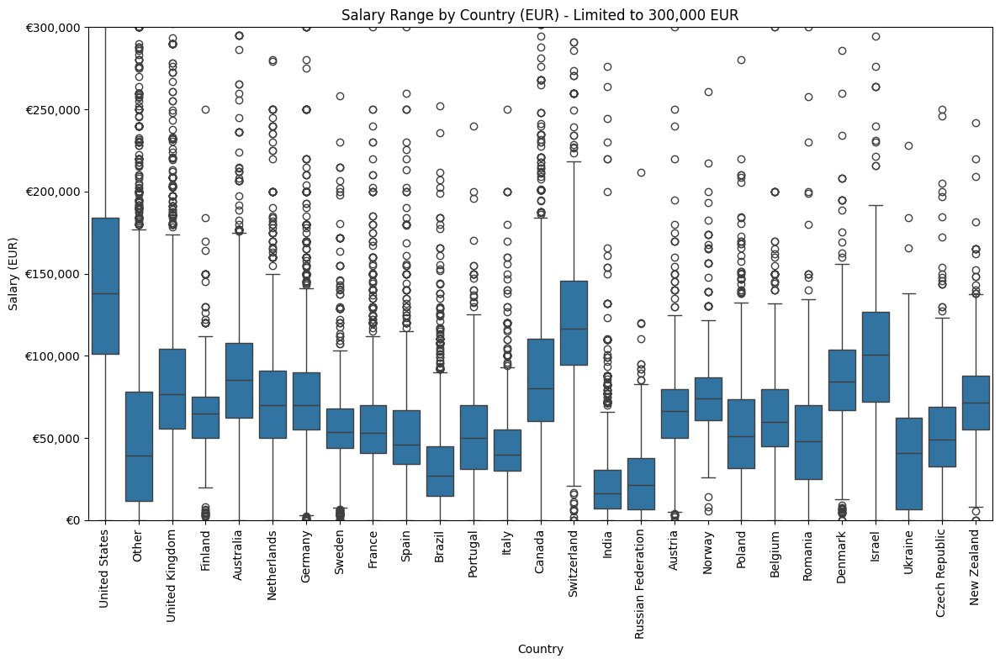

In [17]:
import matplotlib.ticker as mticker

# Set the figure size
plt.figure(figsize=(12, 8))

# Create a box plot for salary range vs country
sns.boxplot(x='country', y='salary_eur', data=df_23)

# Rotate the x-axis labels for better readability
plt.xticks(rotation=90)

# Set the title and labels
plt.title('Salary Range by Country (EUR) - Limited to 300,000 EUR')
plt.xlabel('Country')
plt.ylabel('Salary (EUR)')

# Limit the y-axis to a maximum of 300,000 EUR
plt.ylim(0, 300000)

# Format the y-axis to show proper salary values
plt.gca().yaxis.set_major_formatter(mticker.FuncFormatter(lambda x, _: f'€{x:,.0f}'))

# Show the plot
plt.tight_layout()
plt.show()

In [18]:
import plotly.express as px

# Create a box plot for salary range vs country
fig = px.box(df_23, x='country', y='salary_eur', 
             title='Salary Range by Country (EUR) - Limited to 300,000 EUR',
             labels={'salary_eur': 'Salary (EUR)', 'country': 'Country'})

# Limit the y-axis to a maximum of 300,000 EUR
fig.update_layout(yaxis=dict(range=[0, 300000]))

# Update y-axis formatting to include proper salary display
fig.update_yaxes(tickprefix='€', tickformat=',.0f')

# Display the plot
fig.show()

In [19]:
# check the salariy column and unusual high max values
# Filter the rows where salary_eur is greater than 300,000
high_salary_df = df_23[df_23['salary_eur'] > 300000][['country', 'currency', 'salary', 'salary_eur']]

# Display the filtered rows
display(high_salary_df, high_salary_df['country'].value_counts())

,country,currency,salary,salary_eur
3,Other,PHP,1320000.0,1320000.0
140,Other,KRW,95000000.0,95000000.0
147,Other,Other,24000000.0,480000.0
188,Canada,USD,350000.0,322000.0
224,United States,USD,400000.0,368000.0
...,...,...,...,...
47980,Other,Other,40000000.0,800000.0
47989,Other,Other,16800000.0,336000.0
47995,Other,Other,16800000.0,336000.0
48010,Other,NGN,16000000.0,16000000.0


country
Other             764
United States     619
United Kingdom     32
Canada             21
Germany            15
Switzerland        11
Australia          11
Brazil              8
Netherlands         7
Israel              4
India               3
Poland              3
France              3
Spain               3
Norway              3
Sweden              3
Romania             2
Austria             2
New Zealand         2
Italy               1
Denmark             1
Finland             1
Portugal            1
Belgium             1
Name: count, dtype: int64

In [20]:
# decided to drop rows where salary_eur exceed 300,000 and focus on where the real range lies
# Drop rows where salary_eur is greater than 300,000
df_23_cleaned = df_23[df_23['salary_eur'] <= 300000]

# Verify the number of rows after filtering
print(df_23_cleaned.shape)

# Display a sample of the cleaned data
print(df_23_cleaned[['country', 'currency', 'salary', 'salary_eur']].head())

(46521, 11)
          country currency    salary  salary_eur
0   United States      USD  285000.0    262200.0
1   United States      USD  250000.0    230000.0
2   United States      USD  156000.0    143520.0
4  United Kingdom      GBP   78000.0     90480.0
5   United States      USD  135000.0    124200.0


---

# EDA Analysis:

In [21]:
# Get the value counts for the 'country' column
country_distribution = df_23_cleaned['country'].value_counts().reset_index()
country_distribution.columns = ['country', 'count']

# Create a bar chart for country distribution
fig = px.bar(country_distribution, x='country', y='count', 
             title='Country Distribution',
             labels={'count': 'Number of Respondents', 'country': 'Country'},
             width=1000, height=600)

# Update layout for better visualization
fig.update_layout(xaxis={'categoryorder':'total descending'}, xaxis_title='Country', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

In [22]:
# Get the value counts for the 'age_range' column
age_range_distribution = df_23_cleaned['age_range'].value_counts().reset_index()
age_range_distribution.columns = ['age_range', 'count']

# Create a bar chart for age range distribution
fig = px.bar(age_range_distribution, x='age_range', y='count', 
             title='Age Range Distribution',
             labels={'count': 'Number of Respondents', 'age_range': 'Age Range'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Age Range', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

In [23]:
# Get the value counts for the 'employment' column
employment_distribution = df_23_cleaned['employment'].value_counts().reset_index()
employment_distribution.columns = ['employment', 'count']

# Create a bar chart for employment distribution
fig = px.bar(employment_distribution, x='employment', y='count', 
             title='Employment Distribution',
             labels={'count': 'Number of Respondents', 'employment': 'Employment Type'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Employment Type', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

In [24]:
# Get the value counts for the 'work_location' column
work_location_distribution = df_23_cleaned['work_location'].value_counts().reset_index()
work_location_distribution.columns = ['work_location', 'count']

# Create a bar chart for work location distribution
fig = px.bar(work_location_distribution, x='work_location', y='count', 
             title='Work Location Distribution',
             labels={'count': 'Number of Respondents', 'work_location': 'Work Location'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Work Location', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

In [25]:
# Get the value counts for the 'education_level' column
education_level_distribution = df_23_cleaned['education_level'].value_counts().reset_index()
education_level_distribution.columns = ['education_level', 'count']

# Create a bar chart for education level distribution
fig = px.bar(education_level_distribution, x='education_level', y='count', 
             title='Education Level Distribution',
             labels={'count': 'Number of Respondents', 'education_level': 'Education Level'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Education Level', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

In [26]:
# Get the value counts for the 'type' column
type_distribution = df_23_cleaned['type'].value_counts().reset_index()
type_distribution.columns = ['type', 'count']

# Create a bar chart for type distribution
fig = px.bar(type_distribution, x='type', y='count', 
             title='Job Type Distribution',
             labels={'count': 'Number of Respondents', 'type': 'Job Type'},
             width=1000, height=600)

# Update layout for better visualization
fig.update_layout(xaxis_title='Job Type', yaxis_title='Number of Respondents', 
                  xaxis={'categoryorder':'total descending'})

# Display the plot
fig.show()

In [27]:
# Count of job types by country
job_type_country = df_23_cleaned.groupby(['country', 'type']).size().reset_index(name='count')

fig = px.bar(job_type_country, x='country', y='count', color='type', 
             title='Job Type Demand by Country',
             labels={'count': 'Number of Respondents', 'country': 'Country'},
             width=1000, height=600)

fig.update_layout(xaxis_title='Country', yaxis_title='Number of Respondents', xaxis={'categoryorder':'total descending'})
fig.show()

In [28]:
# Create a box plot for salary range vs country using the cleaned data
fig = px.box(df_23_cleaned, x='country', y='salary_eur', 
             title='Salary Range by Country (EUR) - Salaries Up to 300,000 EUR',
             labels={'salary_eur': 'Salary (EUR)', 'country': 'Country'})

# Update y-axis formatting to include proper salary display
fig.update_yaxes(tickprefix='€', tickformat=',.0f')

# Display the plot
fig.show()

In [29]:
fig = px.strip(df_23_cleaned, x='education_level', y='salary_eur', color='type', 
               title='Salary Distribution by Education Level and Job Type',
               labels={'salary_eur': 'Salary (EUR)', 'education_level': 'Education Level'},
               hover_data=['type'],
               width=1000, height=600)

fig.update_layout(xaxis_title='Education Level', yaxis_title='Salary (EUR)', xaxis={'categoryorder':'total descending'})
fig.show()

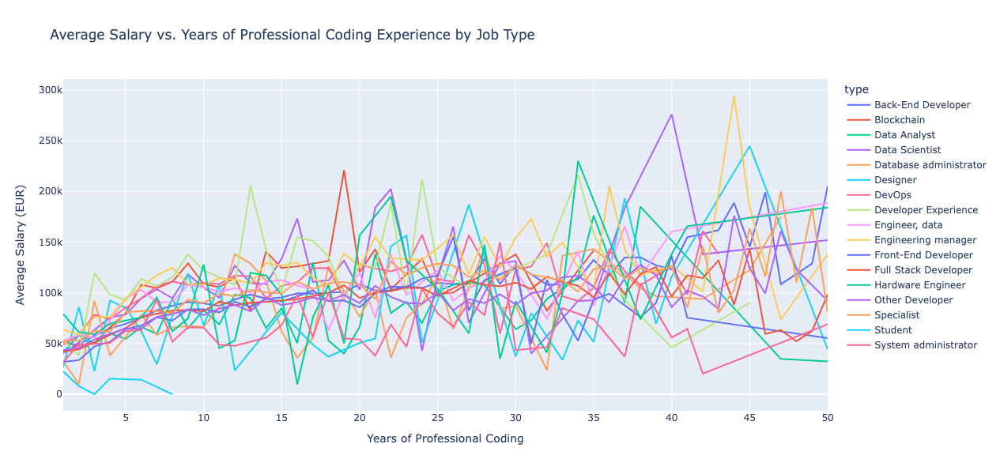

In [30]:
# Group by years of coding and job type to get average salary
salary_experience = df_23_cleaned.groupby(['years_coding_pro', 'type'])['salary_eur'].mean().reset_index()

fig = px.line(salary_experience, x='years_coding_pro', y='salary_eur', color='type', 
              title='Average Salary vs. Years of Professional Coding Experience by Job Type',
              labels={'salary_eur': 'Average Salary (EUR)', 'years_coding_pro': 'Years of Professional Coding'},
              width=1000, height=600)

fig.update_layout(xaxis_title='Years of Professional Coding', yaxis_title='Average Salary (EUR)')
fig.show()

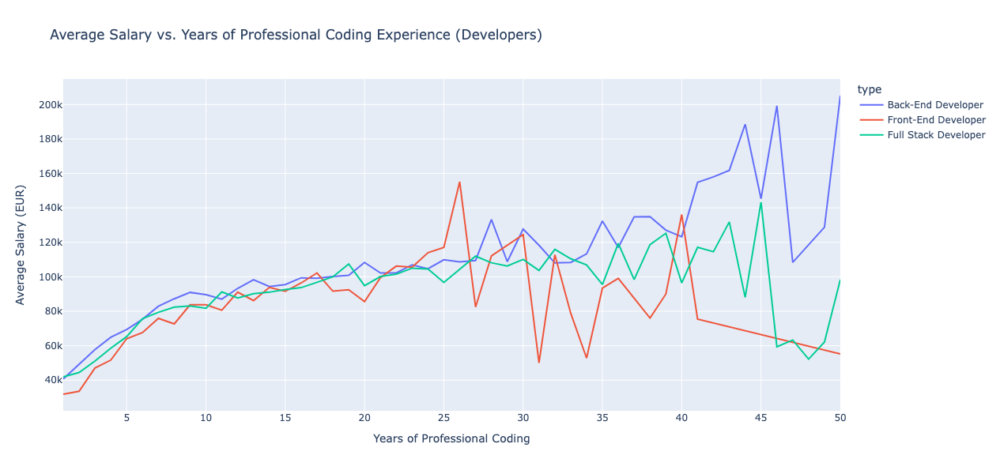

In [31]:
# Define the job types for developers
developer_types = ['Full Stack Developer', 'Back-End Developer', 'Front-End Developer']

# Filter the dataset for developers
developer_salary_experience = df_23_cleaned[df_23_cleaned['type'].isin(developer_types)]

# Group by years of coding and job type to get average salary for developers
developer_salary_experience = developer_salary_experience.groupby(['years_coding_pro', 'type'])['salary_eur'].mean().reset_index()

# Plot the graph for developers
fig = px.line(developer_salary_experience, x='years_coding_pro', y='salary_eur', color='type', 
              title='Average Salary vs. Years of Professional Coding Experience (Developers)',
              labels={'salary_eur': 'Average Salary (EUR)', 'years_coding_pro': 'Years of Professional Coding'},
              width=1000, height=600)

fig.update_layout(xaxis_title='Years of Professional Coding', yaxis_title='Average Salary (EUR)')
fig.show()

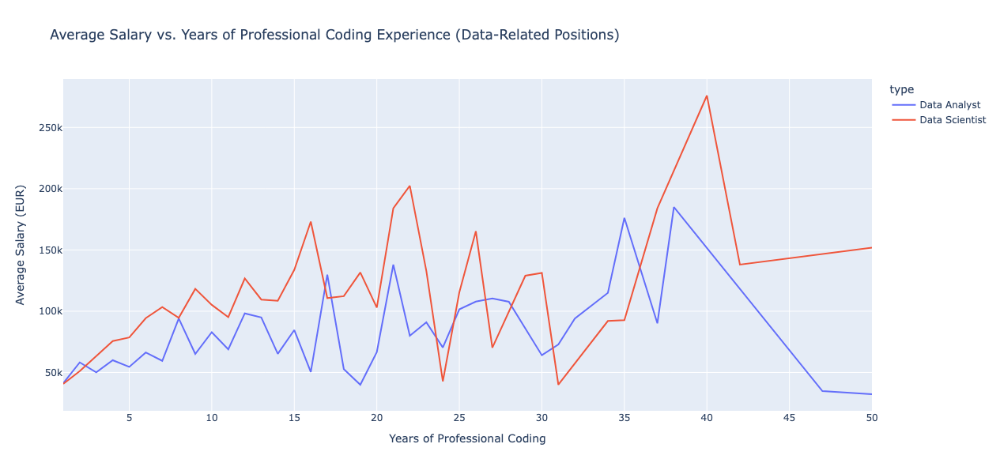

In [32]:
# Define the job types for data-related positions
data_related_types = ['Data Scientist', 'Data Engineer', 'Data Analyst', 'Machine Learning Specialist']

# Filter the dataset for data-related positions
data_salary_experience = df_23_cleaned[df_23_cleaned['type'].isin(data_related_types)]

# Group by years of coding and job type to get average salary for data-related positions
data_salary_experience = data_salary_experience.groupby(['years_coding_pro', 'type'])['salary_eur'].mean().reset_index()

# Plot the graph for data-related positions
fig = px.line(data_salary_experience, x='years_coding_pro', y='salary_eur', color='type', 
              title='Average Salary vs. Years of Professional Coding Experience (Data-Related Positions)',
              labels={'salary_eur': 'Average Salary (EUR)', 'years_coding_pro': 'Years of Professional Coding'},
              width=1000, height=600)

fig.update_layout(xaxis_title='Years of Professional Coding', yaxis_title='Average Salary (EUR)')
fig.show()

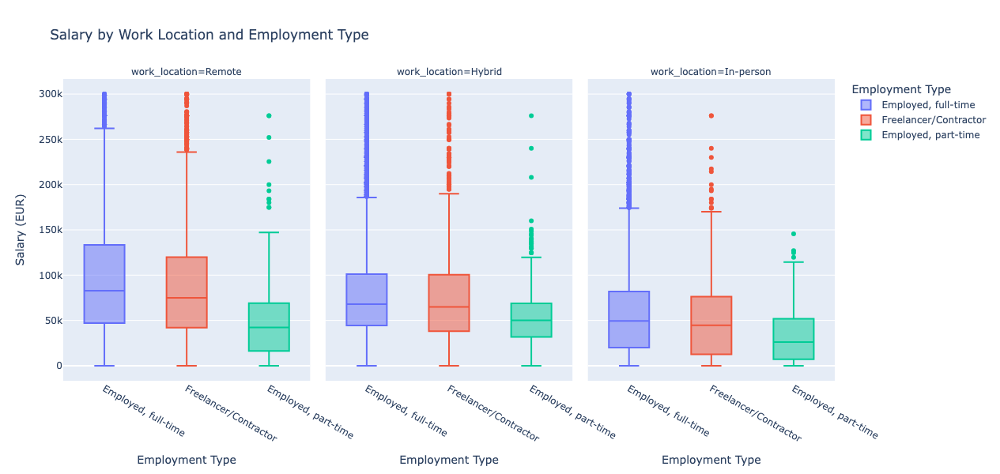

In [33]:
fig = px.box(df_23_cleaned, x='employment', y='salary_eur', color='employment',
             facet_col='work_location', title='Salary by Work Location and Employment Type',
             labels={'salary_eur': 'Salary (EUR)', 'employment': 'Employment Type'},
             width=1000, height=600)

fig.update_layout(xaxis_title='Employment Type', yaxis_title='Salary (EUR)')
fig.show()

In [34]:
# Make a copy of the cleaned table
df_23_cleaned.to_csv('final_df_23.csv', index=False)